# Modelo de Regresión para Series de Tiempo con Imágenes


#### Este trabajo surge como el estudio previo a la creación del modelo final de mi **TFG**.

#### Mi **TFG** consiste en desarrollar un modelo **Imitation Learning** o **Behavior Cloninig** apoyado con **Dagger** dentro de un videojuego

####  **Imitation Learning** o **Behavior Cloninig** consiste en un conjunto de técnicas relacionadas con Reinforcement Learning, donde mediante muestras de un experto un humano, la inteligencia artificial aprende a realizar una acción.

#### En el caso de mi TFG, se trataba de enseñar a una inteligencia artificial a jugar de forma autónoma a un videojuego.

#### Para esto, al entrenar el modelo, necesité utilizar series de tiempo, ya que mi dataset estaba compuesto por:


*   5 imágenes en formato de frames del mapa.
*   5 imágenes en formato de frames de lo que veía el jugador.
*   Una lista que representa el movimiento del personaje con el ratón.

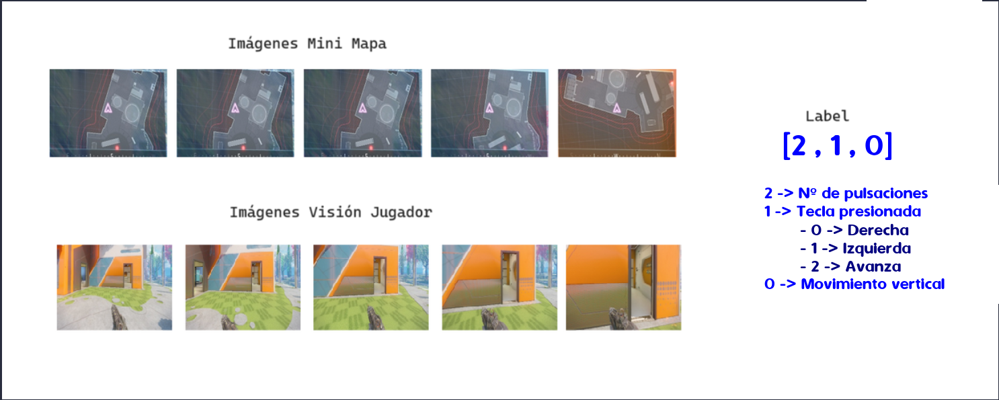

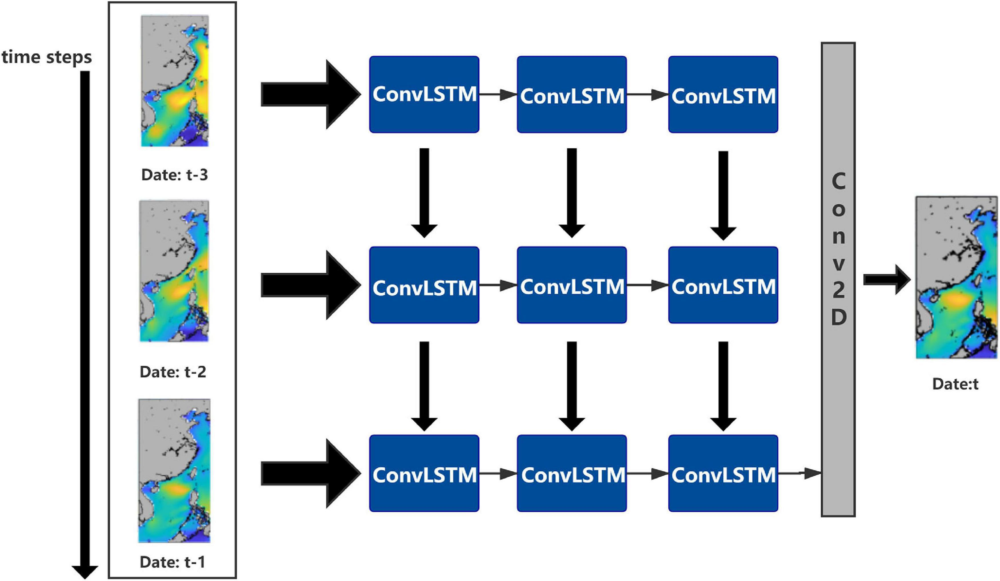

# Resumen del Notebook
#### Para ello, después de recolectar suficientes muestras para crear el modelo, comencé su desarrollo.

#### En este notebook se lleva a cabo:


*   Estudio del Conjunto de Datos
*   Preprocesamiento tanto de las imágenes como de la variable a predecir
*   Preprocesamiento con herramientas como MinMaxScaler o estructuras de normalización
*   Creación de una estructura de batches personalizada para este problema
*   Creacion de modelo de Serie de Tiempo
*   Optimización del modelo
*   Estudio de los resultados Obtenidos

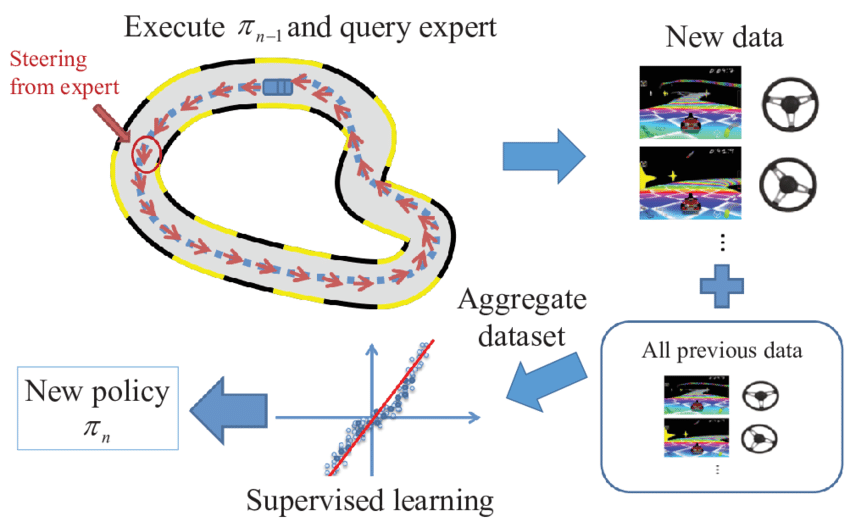

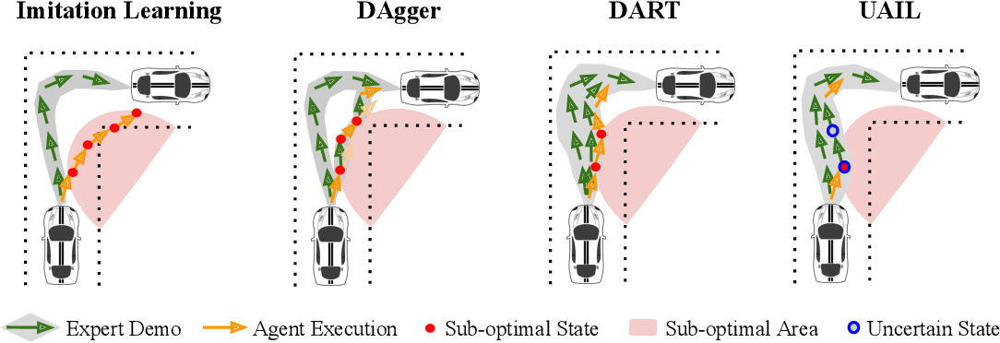

In [1]:
import tensorflow as tf

# Verificar dispositivos disponibles
if tf.test.gpu_device_name():
    print('GPU encontrada:', tf.test.gpu_device_name())
else:
    print("No se encontró GPU. Se utilizará la CPU.")

# Listar todas las GPU disponibles
gpus = tf.config.experimental.list_physical_devices('GPU')

# Configurar el crecimiento de memoria para cada GPU
if gpus:
    for gpu in gpus:
        print("Activada la asignacion de memoria gradual")
        tf.config.experimental.set_memory_growth(gpu, True)

2024-10-18 11:44:21.741314: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-18 11:44:23.304066: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-18 11:44:23.709097: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8463] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-18 11:44:23.792406: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-18 11:44:25.124893: I tensorflow/core/platform/cpu_feature_guar

GPU encontrada: /device:GPU:0
Activada la asignacion de memoria gradual


I0000 00:00:1729244672.006164   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1729244674.443672   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1729244674.443858   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1729244674.515889   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

In [2]:
import numpy as np
import cv2
from PIL import Image, ImageEnhance ,ImageFilter
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import os
#os.environ['TF_GPU_ALLOCATOR'] = 'cuda_malloc_async'

In [3]:
import sqlite3
import shutil
import pandas as pd

 # Comprobar si el archivo existe
if not os.path.exists('../datos/grabacion/base_datos_cod_augmented.db'):
    # Copiar el archivo
    shutil.copy('../datos/grabacion/base_datos_cod.db', '../datos/grabacion/base_datos_cod_augmented.db')
    print("Archivo copiado exitosamente..")
else:
    print("Archivo ya existe..")

# Conectar a la base de datos (crea el archivo si no existe)
conexion = sqlite3.connect("../datos/grabacion/base_datos_cod_augmented.db")

# Crear un cursor para interactuar con la base de datos
cursor = conexion.cursor()

Archivo ya existe..


In [4]:
cursor.execute("SELECT MAX(id) FROM videos_pov")
ID = cursor.fetchone()[0]

if ID == None:
    ID = 0

ID

4431

In [3]:
conexion.close()

### Obtenemos todos los ids donde haya mas de 5 videos

In [5]:
CANTIDAD_VIDEOS = 5

cursor.execute("SELECT id as id_video, COUNT(*) AS cantidad FROM videos_pov GROUP BY id HAVING COUNT(*) > "+str(CANTIDAD_VIDEOS)+"")
resultados = cursor.fetchall()

# Obtener los nombres de las columnas
columnas = [descripcion[0] for descripcion in cursor.description]

# Crear el DataFrame
df_ids = pd.DataFrame(resultados, columns=columnas)

# Utilizando .to_numpy()
ARRAY_ID = df_ids['id_video'].to_numpy()

In [6]:
ARRAY_ID

array([   0,    1,    2, ..., 4429, 4430, 4431])

## DATA AUGMENTATION (IGNORAR SI YA SE APLICO)

In [8]:
def metodo_augmentacion(df, contenido, id, color):
    filas_CN = []
    df_temp = pd.DataFrame()
    
    for index, row in df.iterrows(): 
        indice_img = 0       
        df_row = {}
        intensidad_contrast = np.random.randint(1.5, 2.5)
        intensidad_color = np.random.randint(3, 5)
        intensidad_color = np.random.randint(8, 10)

        for col in df.columns:
            indice_img += 1

            if col == "id":
                df_row[col] = id
            elif col != "etiqueta" and col != "orden" and col != "id":
                # Obtener la ruta de la imagen
                imagen = Image.open("../" + row[col])

                if color == "CN":
                    extension = "CN.jpg"
                    enhancer = ImageEnhance.Color(imagen)
                    imagen_augment01 = enhancer.enhance(intensidad_color)  # Aumento de color
                elif color == "BR":   
                    extension = "BR.jpg"
                    enhancer = ImageEnhance.Contrast(imagen)
                    imagen_augment01 = enhancer.enhance(intensidad_contrast)  # Aumento de contraste
                elif color == "SH":   
                    extension = "SH.jpg"
                    enhancer = ImageEnhance.Sharpness(imagen)
                    imagen_augment01 = enhancer.enhance(intensidad_contrast)  # Aumento de contraste

                # Ruta
                ruta_img = "datos/grabacion/" + str(contenido) + "_augmentation" + "/imagen_" + str(index) + str(indice_img)
                # Guardar la imagen transformada
                imagen_augment01.save("../" + str(ruta_img) + str(extension))
                # Guardar la ruta de la imagen en el DataFrame
                df_row[col] = str(ruta_img) + str(extension)
            elif col == "orden" or col == "etiqueta":
                df_row[col] = row[col]

        filas_CN.append(pd.DataFrame([df_row]))

    # Concatenar todas las filas generadas
    df_temp = pd.concat(filas_CN, ignore_index=True)
    return df_temp


def crear_dataframe(lista_ids,augmentation,contenido):
    global ID
    # Crear un DataFrame vacío para almacenar los resultados
    df_mapa = pd.DataFrame()
    df_pov = pd.DataFrame()

    df_aug_01 = pd.DataFrame()
    df_aug_02 = pd.DataFrame()

    #Si queremos augementacion creamos las carptetas
    if augmentation == True:
        folder_augmentation = "../datos/grabacion/"+str(contenido)+"_augmentation"
        # Comprobar si la carpeta existe
        if os.path.exists(folder_augmentation):
            # Si existe, eliminarla
            shutil.rmtree(folder_augmentation)
            print("Eliminado..")
        
        print("Creando..")
        os.makedirs(folder_augmentation)


    for id in lista_ids:
        query = f"SELECT * FROM videos_mapa WHERE id == {id}"
        query_pov = f"SELECT * FROM videos_pov WHERE id == {id}"

        # Leer el resultado de la consulta y añadirlo al DataFrame
        df_temporal_mapa = pd.read_sql_query(query, conexion)
        df_temporal_pov = pd.read_sql_query(query_pov, conexion)

        if contenido == "pov":
            ID = ID + 2
            fila_aug = metodo_augmentacion(df_temporal_pov,contenido,(ID-1),"CN")
            fila_aug_02 = metodo_augmentacion(df_temporal_pov,contenido,ID,"BR")
            fila_aug_03 = metodo_augmentacion(df_temporal_pov,contenido,ID,"SH")
            df_aug_01 = pd.concat([df_aug_01, fila_aug], ignore_index=True)
            df_aug_02 = pd.concat([df_aug_02, fila_aug_02], ignore_index=True)
            df_aug_02 = pd.concat([df_aug_02, fila_aug_03], ignore_index=True)

        # Concatenar al DataFrame principal
        df_mapa = pd.concat([df_mapa, df_temporal_mapa], ignore_index=True)
        df_pov = pd.concat([df_pov, df_temporal_pov], ignore_index=True)
    
    return df_mapa , df_pov ,pd.concat([df_aug_01, df_aug_02], ignore_index=True)

In [9]:
df_mapa , df_pov ,df_aug = crear_dataframe(ARRAY_ID,True,"pov")

Eliminado..
Creando..


In [10]:
df_aug

,id,orden,pov_01,pov_02,pov_03,pov_04,pov_05,etiqueta
0,2940,1,datos/grabacion/pov_augmentation/imagen_03CN.jpg,datos/grabacion/pov_augmentation/imagen_04CN.jpg,datos/grabacion/pov_augmentation/imagen_05CN.jpg,datos/grabacion/pov_augmentation/imagen_06CN.jpg,datos/grabacion/pov_augmentation/imagen_07CN.jpg,"[1, 2, 0]"
1,2940,2,datos/grabacion/pov_augmentation/imagen_13CN.jpg,datos/grabacion/pov_augmentation/imagen_14CN.jpg,datos/grabacion/pov_augmentation/imagen_15CN.jpg,datos/grabacion/pov_augmentation/imagen_16CN.jpg,datos/grabacion/pov_augmentation/imagen_17CN.jpg,"[1, 1, 0]"
2,2940,3,datos/grabacion/pov_augmentation/imagen_23CN.jpg,datos/grabacion/pov_augmentation/imagen_24CN.jpg,datos/grabacion/pov_augmentation/imagen_25CN.jpg,datos/grabacion/pov_augmentation/imagen_26CN.jpg,datos/grabacion/pov_augmentation/imagen_27CN.jpg,"[1, 0, 0]"
3,2940,4,datos/grabacion/pov_augmentation/imagen_33CN.jpg,datos/grabacion/pov_augmentation/imagen_34CN.jpg,datos/grabacion/pov_augmentation/imagen_35CN.jpg,datos/grabacion/pov_augmentation/imagen_36CN.jpg,datos/grabacion/pov_augmentation/imagen_37CN.jpg,"[3, 1, 0]"
4,2940,5,datos/grabacion/pov_augmentation/imagen_43CN.jpg,datos/grabacion/pov_augmentation/imagen_44CN.jpg,datos/grabacion/pov_augmentation/imagen_45CN.jpg,datos/grabacion/pov_augmentation/imagen_46CN.jpg,datos/grabacion/pov_augmentation/imagen_47CN.jpg,"[1, 2, 0]"
...,...,...,...,...,...,...,...,...
34357,4431,5,datos/grabacion/pov_augmentation/imagen_43SH.jpg,datos/grabacion/pov_augmentation/imagen_44SH.jpg,datos/grabacion/pov_augmentation/imagen_45SH.jpg,datos/grabacion/pov_augmentation/imagen_46SH.jpg,datos/grabacion/pov_augmentation/imagen_47SH.jpg,"[0, 2, 0]"
34358,4431,6,datos/grabacion/pov_augmentation/imagen_53SH.jpg,datos/grabacion/pov_augmentation/imagen_54SH.jpg,datos/grabacion/pov_augmentation/imagen_55SH.jpg,datos/grabacion/pov_augmentation/imagen_56SH.jpg,datos/grabacion/pov_augmentation/imagen_57SH.jpg,"[0, 2, 0]"
34359,4431,7,datos/grabacion/pov_augmentation/imagen_63SH.jpg,datos/grabacion/pov_augmentation/imagen_64SH.jpg,datos/grabacion/pov_augmentation/imagen_65SH.jpg,datos/grabacion/pov_augmentation/imagen_66SH.jpg,datos/grabacion/pov_augmentation/imagen_67SH.jpg,"[2, 0, 0]"
34360,4431,8,datos/grabacion/pov_augmentation/imagen_73SH.jpg,datos/grabacion/pov_augmentation/imagen_74SH.jpg,datos/grabacion/pov_augmentation/imagen_75SH.jpg,datos/grabacion/pov_augmentation/imagen_76SH.jpg,datos/grabacion/pov_augmentation/imagen_77SH.jpg,"[1, 2, 0]"


In [11]:
df_pov

,id,orden,pov_01,pov_02,pov_03,pov_04,pov_05,etiqueta
0,0,1,datos/grabacion/pov/pov_07-20-03-29-043653.jpg,datos/grabacion/pov/pov_07-20-03-29-209051.jpg,datos/grabacion/pov/pov_07-20-03-29-345685.jpg,datos/grabacion/pov/pov_07-20-03-29-482897.jpg,datos/grabacion/pov/pov_07-20-03-29-609801.jpg,"[1, 2, 0]"
1,0,2,datos/grabacion/pov/pov_07-20-03-30-185956.jpg,datos/grabacion/pov/pov_07-20-03-30-315652.jpg,datos/grabacion/pov/pov_07-20-03-30-440766.jpg,datos/grabacion/pov/pov_07-20-03-30-565813.jpg,datos/grabacion/pov/pov_07-20-03-30-695511.jpg,"[1, 1, 0]"
2,0,3,datos/grabacion/pov/pov_07-20-03-31-270960.jpg,datos/grabacion/pov/pov_07-20-03-31-403256.jpg,datos/grabacion/pov/pov_07-20-03-31-534690.jpg,datos/grabacion/pov/pov_07-20-03-31-666910.jpg,datos/grabacion/pov/pov_07-20-03-31-794486.jpg,"[1, 0, 0]"
3,0,4,datos/grabacion/pov/pov_07-20-03-32-371110.jpg,datos/grabacion/pov/pov_07-20-03-32-499864.jpg,datos/grabacion/pov/pov_07-20-03-32-630945.jpg,datos/grabacion/pov/pov_07-20-03-32-768306.jpg,datos/grabacion/pov/pov_07-20-03-32-911935.jpg,"[3, 1, 0]"
4,0,5,datos/grabacion/pov/pov_07-20-03-33-507854.jpg,datos/grabacion/pov/pov_07-20-03-33-639038.jpg,datos/grabacion/pov/pov_07-20-03-33-769472.jpg,datos/grabacion/pov/pov_07-20-03-33-900121.jpg,datos/grabacion/pov/pov_07-20-03-34-033513.jpg,"[1, 2, 0]"
...,...,...,...,...,...,...,...,...
11449,1438,5,datos/grabacion/pov/pov_13-15-53-15-088289.jpg,datos/grabacion/pov/pov_13-15-53-15-214287.jpg,datos/grabacion/pov/pov_13-15-53-15-349081.jpg,datos/grabacion/pov/pov_13-15-53-15-477937.jpg,datos/grabacion/pov/pov_13-15-53-15-604005.jpg,"[0, 2, 0]"
11450,1438,6,datos/grabacion/pov/pov_13-15-53-16-179159.jpg,datos/grabacion/pov/pov_13-15-53-16-302088.jpg,datos/grabacion/pov/pov_13-15-53-16-429703.jpg,datos/grabacion/pov/pov_13-15-53-16-552264.jpg,datos/grabacion/pov/pov_13-15-53-16-680613.jpg,"[0, 2, 0]"
11451,1438,7,datos/grabacion/pov/pov_13-15-53-17-258053.jpg,datos/grabacion/pov/pov_13-15-53-17-383256.jpg,datos/grabacion/pov/pov_13-15-53-17-509836.jpg,datos/grabacion/pov/pov_13-15-53-17-633639.jpg,datos/grabacion/pov/pov_13-15-53-17-759922.jpg,"[2, 0, 0]"
11452,1438,8,datos/grabacion/pov/pov_13-15-53-18-335870.jpg,datos/grabacion/pov/pov_13-15-53-18-463045.jpg,datos/grabacion/pov/pov_13-15-53-18-586132.jpg,datos/grabacion/pov/pov_13-15-53-18-714027.jpg,datos/grabacion/pov/pov_13-15-53-18-836930.jpg,"[1, 2, 0]"


In [12]:
df_pov = pd.concat([df_pov, df_aug], ignore_index=True)

In [13]:
df_pov

,id,orden,pov_01,pov_02,pov_03,pov_04,pov_05,etiqueta
0,0,1,datos/grabacion/pov/pov_07-20-03-29-043653.jpg,datos/grabacion/pov/pov_07-20-03-29-209051.jpg,datos/grabacion/pov/pov_07-20-03-29-345685.jpg,datos/grabacion/pov/pov_07-20-03-29-482897.jpg,datos/grabacion/pov/pov_07-20-03-29-609801.jpg,"[1, 2, 0]"
1,0,2,datos/grabacion/pov/pov_07-20-03-30-185956.jpg,datos/grabacion/pov/pov_07-20-03-30-315652.jpg,datos/grabacion/pov/pov_07-20-03-30-440766.jpg,datos/grabacion/pov/pov_07-20-03-30-565813.jpg,datos/grabacion/pov/pov_07-20-03-30-695511.jpg,"[1, 1, 0]"
2,0,3,datos/grabacion/pov/pov_07-20-03-31-270960.jpg,datos/grabacion/pov/pov_07-20-03-31-403256.jpg,datos/grabacion/pov/pov_07-20-03-31-534690.jpg,datos/grabacion/pov/pov_07-20-03-31-666910.jpg,datos/grabacion/pov/pov_07-20-03-31-794486.jpg,"[1, 0, 0]"
3,0,4,datos/grabacion/pov/pov_07-20-03-32-371110.jpg,datos/grabacion/pov/pov_07-20-03-32-499864.jpg,datos/grabacion/pov/pov_07-20-03-32-630945.jpg,datos/grabacion/pov/pov_07-20-03-32-768306.jpg,datos/grabacion/pov/pov_07-20-03-32-911935.jpg,"[3, 1, 0]"
4,0,5,datos/grabacion/pov/pov_07-20-03-33-507854.jpg,datos/grabacion/pov/pov_07-20-03-33-639038.jpg,datos/grabacion/pov/pov_07-20-03-33-769472.jpg,datos/grabacion/pov/pov_07-20-03-33-900121.jpg,datos/grabacion/pov/pov_07-20-03-34-033513.jpg,"[1, 2, 0]"
...,...,...,...,...,...,...,...,...
45811,4431,5,datos/grabacion/pov_augmentation/imagen_43SH.jpg,datos/grabacion/pov_augmentation/imagen_44SH.jpg,datos/grabacion/pov_augmentation/imagen_45SH.jpg,datos/grabacion/pov_augmentation/imagen_46SH.jpg,datos/grabacion/pov_augmentation/imagen_47SH.jpg,"[0, 2, 0]"
45812,4431,6,datos/grabacion/pov_augmentation/imagen_53SH.jpg,datos/grabacion/pov_augmentation/imagen_54SH.jpg,datos/grabacion/pov_augmentation/imagen_55SH.jpg,datos/grabacion/pov_augmentation/imagen_56SH.jpg,datos/grabacion/pov_augmentation/imagen_57SH.jpg,"[0, 2, 0]"
45813,4431,7,datos/grabacion/pov_augmentation/imagen_63SH.jpg,datos/grabacion/pov_augmentation/imagen_64SH.jpg,datos/grabacion/pov_augmentation/imagen_65SH.jpg,datos/grabacion/pov_augmentation/imagen_66SH.jpg,datos/grabacion/pov_augmentation/imagen_67SH.jpg,"[2, 0, 0]"
45814,4431,8,datos/grabacion/pov_augmentation/imagen_73SH.jpg,datos/grabacion/pov_augmentation/imagen_74SH.jpg,datos/grabacion/pov_augmentation/imagen_75SH.jpg,datos/grabacion/pov_augmentation/imagen_76SH.jpg,datos/grabacion/pov_augmentation/imagen_77SH.jpg,"[1, 2, 0]"


In [14]:
# Insertar el DataFrame en la tabla 'videos_mapa'
df_pov.to_sql('videos_pov', conexion, if_exists='replace', index=False)

In [15]:
conexion.close()

# SIN AUGMENTACION DE DATOS

### Separacion Dataset

In [7]:
# Dividir en entrenamiento y prueba (10% para prueba)
X_train_Mapa, X_test_Mapa = train_test_split(ARRAY_ID, test_size=0.1, random_state=42)
# Dividir entrenamiento en entrenamiento y validación (30% de 90% para validación)
X_train_Mapa, X_valid_Mapa = train_test_split(X_train_Mapa, test_size=0.3, random_state=42)

In [8]:
print("train ->"+str(len(X_train_Mapa)))
print("valid ->"+str(len(X_valid_Mapa)))
print("test ->"+str(len(X_test_Mapa)))

train ->1409
valid ->605
test ->224


In [9]:
def crear_dataframe(lista_ids):
    # Crear un DataFrame vacío para almacenar los resultados
    df_mapa = pd.DataFrame()
    df_pov = pd.DataFrame()

    for id in lista_ids:
        query = f"SELECT * FROM videos_mapa WHERE id == {id}"
        query_pov = f"SELECT * FROM videos_pov WHERE id == {id}"

        # Leer el resultado de la consulta y añadirlo al DataFrame
        df_temporal = pd.read_sql_query(query, conexion)
        df_temporal_pov = pd.read_sql_query(query_pov, conexion)

        # Concatenar al DataFrame principal
        df_mapa = pd.concat([df_mapa, df_temporal], ignore_index=True)
        df_pov = pd.concat([df_pov, df_temporal_pov], ignore_index=True)
    
    return df_mapa , df_pov

In [10]:
df_train_mapa , df_train_pov = crear_dataframe(X_train_Mapa)
df_valid_mapa , df_valid_pov = crear_dataframe(X_valid_Mapa)
df_test_mapa , df_test_pov = crear_dataframe(X_test_Mapa)

In [11]:
df_train_pov[:30]

,id,orden,pov_01,pov_02,pov_03,pov_04,pov_05,etiqueta
0,2975,0,datos/grabacion/pov_augmentation/imagen_03BR.jpg,datos/grabacion/pov_augmentation/imagen_04BR.jpg,datos/grabacion/pov_augmentation/imagen_05BR.jpg,datos/grabacion/pov_augmentation/imagen_06BR.jpg,datos/grabacion/pov_augmentation/imagen_07BR.jpg,"[1, 2, 0]"
1,2975,1,datos/grabacion/pov_augmentation/imagen_13BR.jpg,datos/grabacion/pov_augmentation/imagen_14BR.jpg,datos/grabacion/pov_augmentation/imagen_15BR.jpg,datos/grabacion/pov_augmentation/imagen_16BR.jpg,datos/grabacion/pov_augmentation/imagen_17BR.jpg,"[1, 2, 0]"
2,2975,2,datos/grabacion/pov_augmentation/imagen_23BR.jpg,datos/grabacion/pov_augmentation/imagen_24BR.jpg,datos/grabacion/pov_augmentation/imagen_25BR.jpg,datos/grabacion/pov_augmentation/imagen_26BR.jpg,datos/grabacion/pov_augmentation/imagen_27BR.jpg,"[0, 2, 0]"
3,2975,3,datos/grabacion/pov_augmentation/imagen_33BR.jpg,datos/grabacion/pov_augmentation/imagen_34BR.jpg,datos/grabacion/pov_augmentation/imagen_35BR.jpg,datos/grabacion/pov_augmentation/imagen_36BR.jpg,datos/grabacion/pov_augmentation/imagen_37BR.jpg,"[2, 0, 0]"
4,2975,4,datos/grabacion/pov_augmentation/imagen_43BR.jpg,datos/grabacion/pov_augmentation/imagen_44BR.jpg,datos/grabacion/pov_augmentation/imagen_45BR.jpg,datos/grabacion/pov_augmentation/imagen_46BR.jpg,datos/grabacion/pov_augmentation/imagen_47BR.jpg,"[0, 2, 0]"
5,2975,5,datos/grabacion/pov_augmentation/imagen_53BR.jpg,datos/grabacion/pov_augmentation/imagen_54BR.jpg,datos/grabacion/pov_augmentation/imagen_55BR.jpg,datos/grabacion/pov_augmentation/imagen_56BR.jpg,datos/grabacion/pov_augmentation/imagen_57BR.jpg,"[0, 2, 0]"
6,2975,6,datos/grabacion/pov_augmentation/imagen_63BR.jpg,datos/grabacion/pov_augmentation/imagen_64BR.jpg,datos/grabacion/pov_augmentation/imagen_65BR.jpg,datos/grabacion/pov_augmentation/imagen_66BR.jpg,datos/grabacion/pov_augmentation/imagen_67BR.jpg,"[1, 1, 0]"
7,2975,7,datos/grabacion/pov_augmentation/imagen_73BR.jpg,datos/grabacion/pov_augmentation/imagen_74BR.jpg,datos/grabacion/pov_augmentation/imagen_75BR.jpg,datos/grabacion/pov_augmentation/imagen_76BR.jpg,datos/grabacion/pov_augmentation/imagen_77BR.jpg,"[1, 0, 0]"
8,2975,8,datos/grabacion/pov_augmentation/imagen_83BR.jpg,datos/grabacion/pov_augmentation/imagen_84BR.jpg,datos/grabacion/pov_augmentation/imagen_85BR.jpg,datos/grabacion/pov_augmentation/imagen_86BR.jpg,datos/grabacion/pov_augmentation/imagen_87BR.jpg,"[1, 1, 0]"
9,2975,9,datos/grabacion/pov_augmentation/imagen_93BR.jpg,datos/grabacion/pov_augmentation/imagen_94BR.jpg,datos/grabacion/pov_augmentation/imagen_95BR.jpg,datos/grabacion/pov_augmentation/imagen_96BR.jpg,datos/grabacion/pov_augmentation/imagen_97BR.jpg,"[0, 2, 0]"


In [12]:
import ast

def preprocesado_df(df):
    # Convertir la columna de tipo object a listas de enteros
    df['etiqueta'] = df['etiqueta'].apply(ast.literal_eval)
    # Eliminamos las filas donde 'mouse_final' sea igual a [0, 4]
    filtro = df['etiqueta'].apply(lambda x: x[1] == 4)
    df = df[~filtro]
    # Crear un filtro booleano para las filas que cumplen la condición
    condicion = df['etiqueta'].apply(lambda x: x[1] == 2)
    # Juntamos las pulsaciones y tecla en una columna
    #x_positions_2 = df['etiqueta'].apply(lambda x: str(x[0])+str(x[1]))
    x_positions_2 = df['etiqueta'].apply(lambda x: str(x[1]))
    df['etiqueta'] = x_positions_2
    # Modificar solo las filas que cumplen con la condición
    #df.loc[condicion, 'etiqueta'] = df.loc[condicion, 'etiqueta'].apply(lambda x: "12")
    return df

In [13]:
df_train_pov = preprocesado_df(df_train_pov)
df_valid_pov = preprocesado_df(df_valid_pov)
df_test_pov = preprocesado_df(df_test_pov)

/tmp/ipykernel_38743/1242670720.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['etiqueta'] = x_positions_2


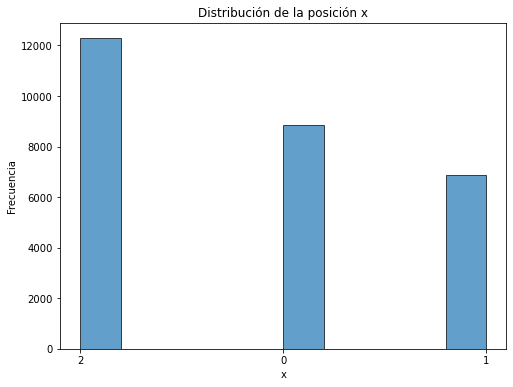

In [14]:
# Extraer la primera posición sin modificar el DataFrame
x_positions = df_train_pov['etiqueta'].apply(lambda x: x[0])

# Crear la figura y el eje
fig, ax = plt.subplots(figsize=(8, 6))

# Crear el histograma
ax.hist(x_positions, bins=10, edgecolor='black', alpha=0.7)

# Agregar el título y las etiquetas de los ejes
ax.set_title('Distribución de la posición x')
ax.set_xlabel('x')
ax.set_ylabel('Frecuencia')

# Mostrar la figura
plt.show()

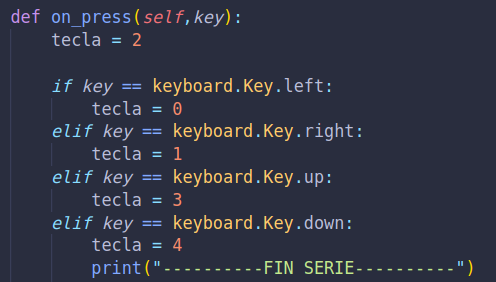

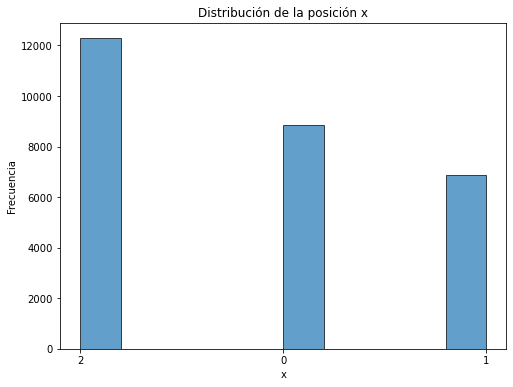

In [15]:
# Crear la figura y el eje
fig, ax = plt.subplots(figsize=(8, 6))

# Crear el histograma
ax.hist(df_train_pov['etiqueta'], bins=10, edgecolor='black', alpha=0.7)

# Agregar el título y las etiquetas de los ejes
ax.set_title('Distribución de la posición x')
ax.set_xlabel('x')
ax.set_ylabel('Frecuencia')

# Mostrar la figura
plt.show()

### One-Hot Encoding y balanceo de pesos

In [16]:
from sklearn.utils import class_weight

def aplicar_one_hot_balanceo(df,columa):
    # Crear un DataFrame con las columnas de one-hot encoding
    one_hot_df = pd.get_dummies(df[columa], prefix='label')

    # Unir el DataFrame original con el DataFrame de one-hot encoding
    df = pd.concat([df, one_hot_df], axis=1)

    # Balanceamos los pesos para el entrenamiento
    class_weights = class_weight.compute_class_weight(
        class_weight='balanced',
        classes=np.unique(df[columa]),
        y=df[columa]
    )

    # Crear un diccionario de pesos para las clases
    class_weight_dict = {i: class_weights[i] for i in range(len(class_weights))}

    #Eliminamos la columna original
    df = df.drop(columa, axis=1)
    return df , class_weight_dict

In [17]:
df_train_pov , pesos_train = aplicar_one_hot_balanceo(df_train_pov,"etiqueta")
df_valid_pov , pesos_valid = aplicar_one_hot_balanceo(df_valid_pov,"etiqueta")
df_test_pov , pesos_test= aplicar_one_hot_balanceo(df_test_pov,"etiqueta")

In [18]:
df_train_pov[:5]

,id,orden,pov_01,pov_02,pov_03,pov_04,pov_05,label_0,label_1,label_2
0,2975,0,datos/grabacion/pov_augmentation/imagen_03BR.jpg,datos/grabacion/pov_augmentation/imagen_04BR.jpg,datos/grabacion/pov_augmentation/imagen_05BR.jpg,datos/grabacion/pov_augmentation/imagen_06BR.jpg,datos/grabacion/pov_augmentation/imagen_07BR.jpg,0,0,1
1,2975,1,datos/grabacion/pov_augmentation/imagen_13BR.jpg,datos/grabacion/pov_augmentation/imagen_14BR.jpg,datos/grabacion/pov_augmentation/imagen_15BR.jpg,datos/grabacion/pov_augmentation/imagen_16BR.jpg,datos/grabacion/pov_augmentation/imagen_17BR.jpg,0,0,1
2,2975,2,datos/grabacion/pov_augmentation/imagen_23BR.jpg,datos/grabacion/pov_augmentation/imagen_24BR.jpg,datos/grabacion/pov_augmentation/imagen_25BR.jpg,datos/grabacion/pov_augmentation/imagen_26BR.jpg,datos/grabacion/pov_augmentation/imagen_27BR.jpg,0,0,1
3,2975,3,datos/grabacion/pov_augmentation/imagen_33BR.jpg,datos/grabacion/pov_augmentation/imagen_34BR.jpg,datos/grabacion/pov_augmentation/imagen_35BR.jpg,datos/grabacion/pov_augmentation/imagen_36BR.jpg,datos/grabacion/pov_augmentation/imagen_37BR.jpg,1,0,0
4,2975,4,datos/grabacion/pov_augmentation/imagen_43BR.jpg,datos/grabacion/pov_augmentation/imagen_44BR.jpg,datos/grabacion/pov_augmentation/imagen_45BR.jpg,datos/grabacion/pov_augmentation/imagen_46BR.jpg,datos/grabacion/pov_augmentation/imagen_47BR.jpg,0,0,1


In [19]:
pesos_train

{0: 1.0538386344837958, 1: 1.3586350637390334, 2: 0.7604242966821302}

## Lista con las etiquetas 

In [20]:
ETIQUETAS = np.array(df_train_pov.filter(like='label').columns.tolist())

In [21]:
ETIQUETAS

array(['label_0', 'label_1', 'label_2'], dtype='<U7')

In [22]:
len(ETIQUETAS)

3

## Visualizacion DataFrame

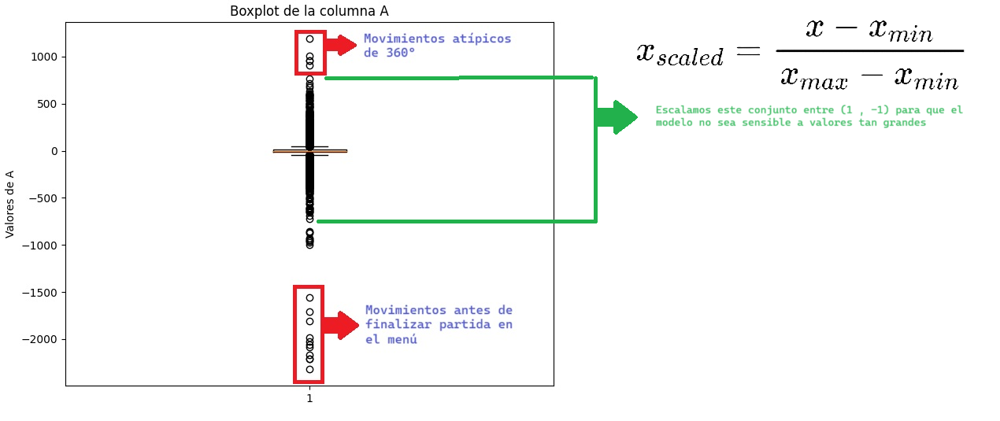

## Visualizacion Imagenes Dataset

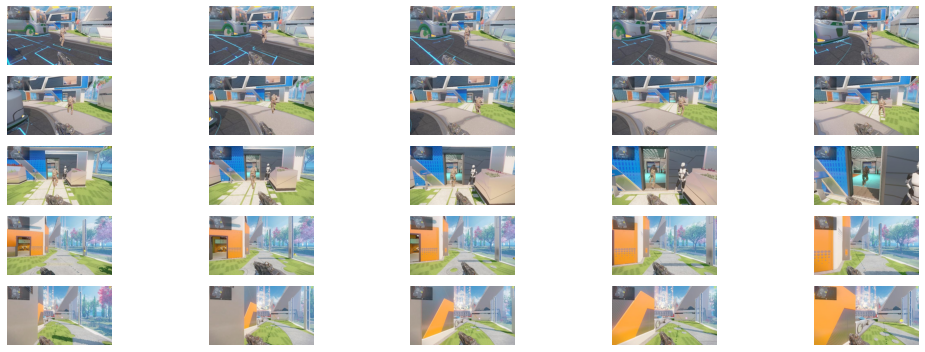

In [23]:
posicion_x = 10

fig, axes = plt.subplots(5, 5, figsize=(15, 5))

for i in range(5):
    for j in range(5):
        # Obtener la ruta de la imagen
        ruta_imagen = df_train_pov.iloc[(posicion_x+i), (j+2)]  # Usamos j+2 para compensar el cambio de rango

        # Abrir la imagen y convertirla a matriz numpy
        imagen = Image.open("../" + ruta_imagen)
        matriz_np = np.array(imagen)

        # Mostrar la imagen en el subplot correspondiente
        axes[i, j].imshow(matriz_np)
        axes[i, j].axis('off')

plt.tight_layout()
plt.show()


Tamaño imagen -> (512, 288)
Tamaño matriz -> (168, 300, 3)


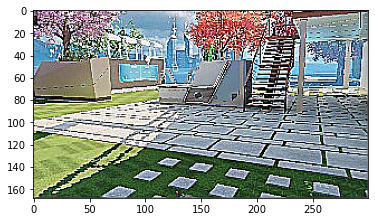

In [42]:
primera_fila = df_train_pov.iloc[0]
imagen = Image.open("../" +str(primera_fila.iloc[2]))
ancho, alto = imagen.size

# Definir un factor de zoom (por ejemplo, 2x)
factor_zoom = 1.7

# Calcular las coordenadas para la región central de la imagen
x_centro = ancho // 2
y_centro = alto // 2

# Calcular el tamaño del área que vamos a recortar
zoom_ancho = ancho // factor_zoom
zoom_alto = alto // factor_zoom

# Recortar la región de interés (ROI)
roi = imagen.crop((
    x_centro - zoom_ancho // 2,
    y_centro - zoom_alto // 2,
    x_centro + zoom_ancho // 2,
    y_centro + zoom_alto // 2
))

enhancer = ImageEnhance.Sharpness(roi)
imagen_augment01 = enhancer.enhance(10)  # Aumento de contraste

matriz_np = np.array(imagen_augment01)
print("Tamaño imagen -> "+str(imagen.size))
print("Tamaño matriz -> "+ str(matriz_np.shape))
plt.imshow(matriz_np)
plt.axis('on')
plt.show()

Tamaño imagen -> (300, 168)
Tamaño matriz -> (168, 300, 3)


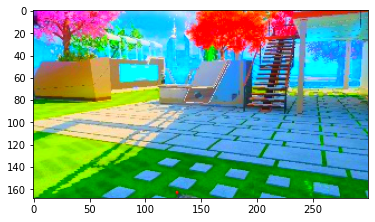

In [47]:
primera_fila = df_train_pov.iloc[0]
imagen = Image.open("../" +str(primera_fila.iloc[2]))
ancho, alto = imagen.size

# Definir un factor de zoom (por ejemplo, 2x)
factor_zoom = 1.7

# Calcular las coordenadas para la región central de la imagen
x_centro = ancho // 2
y_centro = alto // 2

# Calcular el tamaño del área que vamos a recortar
zoom_ancho = ancho // factor_zoom
zoom_alto = alto // factor_zoom

# Recortar la región de interés (ROI)
roi = imagen.crop((
    x_centro - zoom_ancho // 2,
    y_centro - zoom_alto // 2,
    x_centro + zoom_ancho // 2,
    y_centro + zoom_alto // 2
))

enhancer = ImageEnhance.Color(roi)
imagen_augment01 = enhancer.enhance(5)  # Aumento de contraste
matriz_np = np.array(imagen_augment01)
print("Tamaño imagen -> "+str(imagen_augment01.size))
print("Tamaño matriz -> "+ str(matriz_np.shape))
plt.imshow(matriz_np)
plt.axis('on')
plt.show()

Tamaño imagen -> (300, 168)
Tamaño matriz -> (168, 300, 3)


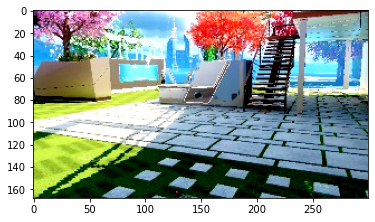

In [46]:
primera_fila = df_train_pov.iloc[0]
imagen = Image.open("../" +str(primera_fila.iloc[2]))
ancho, alto = imagen.size

# Definir un factor de zoom (por ejemplo, 2x)
factor_zoom = 1.7

# Calcular las coordenadas para la región central de la imagen
x_centro = ancho // 2
y_centro = alto // 2

# Calcular el tamaño del área que vamos a recortar
zoom_ancho = ancho // factor_zoom
zoom_alto = alto // factor_zoom

# Recortar la región de interés (ROI)
roi = imagen.crop((
    x_centro - zoom_ancho // 2,
    y_centro - zoom_alto // 2,
    x_centro + zoom_ancho // 2,
    y_centro + zoom_alto // 2
))

enhancer = ImageEnhance.Contrast(roi)
imagen_augment01 = enhancer.enhance(2)  # Aumento de contraste
matriz_np = np.array(imagen_augment01)
print("Tamaño imagen -> "+str(imagen_augment01.size))
print("Tamaño matriz -> "+ str(matriz_np.shape))
plt.imshow(matriz_np)
plt.axis('on')
plt.show()

# Funcion Del Batch

In [24]:
from keras.utils import Sequence

class ImageDataGenerator(Sequence):
    def __init__(self, df , sequence_length ,image_height , image_width , batch_size, filtro, **kwargs):
        self.df = df
        self.image_sequence_length = sequence_length
        self.image_height = image_height
        self.image_width = image_width
        self.batch_size = batch_size
        self.POV = filtro
        super().__init__(**kwargs)  # Llamada al constructor de la clase base

    def __len__(self):
        return int(np.ceil(len(self.df) / float(self.batch_size)))

    def cargar_todo(self,fin_df):
        batch_df = self.df.iloc[0:fin_df]     #Obtenemos un lote del df

        X_batch = np.zeros((len(batch_df), self.image_sequence_length ,self.image_height, self.image_width, 3))  # Inicializar matriz para las imágenes
        #y_batch = batch_df[['izquieda', 'derecha', 'delante']].values
        y_batch = np.array(batch_df['mouse_final'].tolist())

        for i, (_, row) in enumerate(batch_df.iterrows()):
            frames = []
            for j in range(self.image_sequence_length):
                imagen = Image.open("../" + row.iloc[j])    # Obtener la ruta de la imagen
                imagen = Image.fromarray(np.array(imagen)).filter(ImageFilter.SHARPEN)  #Aplicamos Filtro SHARPEN
                imagen = np.array(imagen) / 255.0           # Normalizar la imagen

                frames.append(imagen)                  #Juntamos frames en lista
            video = np.stack(frames, axis=0)           # Convertir lista de frames en un video np
            X_batch[i] = video

        return X_batch, y_batch

    def __getitem__(self, index):
        inicio_lote = index * self.batch_size
        final_lote = (index + 1) * self.batch_size

        batch_df = self.df.iloc[inicio_lote:final_lote]     #Obtenemos un lote del df

        X_batch = np.zeros((len(batch_df), self.image_sequence_length ,self.image_height, self.image_width, 3))  # Inicializar matriz para las imágenes
        # Obtener y_batch después del one-hot encoding

        # Filtrar las columnas que comienzan con 'label'
        y_batch = batch_df.filter(like='label').values

        for i, (_, row) in enumerate(batch_df.iterrows()):
            frames = []
            for j in range(self.image_sequence_length):
                imagen = Image.open("../" + row.iloc[j+2])    # Obtener la ruta de la imagen
                ancho, alto = imagen.size

                # Definir un factor de zoom (por ejemplo, 2x)
                factor_zoom = 1.7

                # Calcular las coordenadas para la región central de la imagen
                x_centro = ancho // 2
                y_centro = alto // 2

                # Calcular el tamaño del área que vamos a recortar
                zoom_ancho = ancho // factor_zoom
                zoom_alto = alto // factor_zoom

                # Recortar la región de interés (ROI)
                imagen = imagen.crop((
                    x_centro - zoom_ancho // 2,
                    y_centro - zoom_alto // 2,
                    x_centro + zoom_ancho // 2,
                    y_centro + zoom_alto // 2
                ))

                if self.POV == True :
                    imagen = imagen.rotate(2.5, expand=True)
                    # Recorta la imagen (izquierda, superior, derecha, inferior)
                    imagen = imagen.crop((5, 12, ancho - 35, alto-25))
                    imagen = ImageEnhance.Sharpness(imagen)
                    imagen = imagen.enhance(7)  # Aumento de contraste

                imagen = np.array(imagen) / 255.0           # Normalizar la imagen

                frames.append(imagen)                  #Juntamos frames en lista
            video = np.stack(frames, axis=0)           # Convertir lista de frames en un video np
            X_batch[i] = video

        return X_batch, y_batch

def comprobar_contenido(X_train , Y_train , num_video):

    fig, axs = plt.subplots(1, 5, figsize=(5 * 2, 1 * 2))

    for i in range(5):
        axs[i].imshow(X_train[num_video][i])
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()
    print(Y_train[num_video])
    return Y_train[num_video]

# PREPARACIÒN ENTRENAMIENTO

## Train Split

# Generadores

In [25]:
BATCH = CANTIDAD_VIDEOS

In [26]:
# Generador Mapa
altura_img_mini = 168
anchura_img_mini = 300
batch_size = BATCH #videos por batch

# Generadores de Batches Mini-Mapa
train_generator_pov = ImageDataGenerator(df_train_pov, sequence_length=5, image_height=altura_img_mini, image_width=anchura_img_mini, batch_size=batch_size ,filtro =False)
test_generator_pov = ImageDataGenerator(df_test_pov, sequence_length=5, image_height=altura_img_mini, image_width=anchura_img_mini, batch_size=batch_size ,filtro =False)
valid_generator_pov = ImageDataGenerator(df_valid_pov, sequence_length=5, image_height=altura_img_mini, image_width=anchura_img_mini, batch_size=batch_size ,filtro =False)

5606


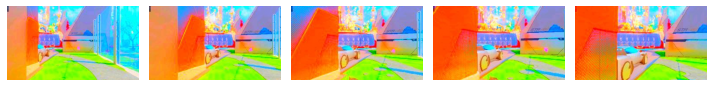

[1 0 0]
label_0


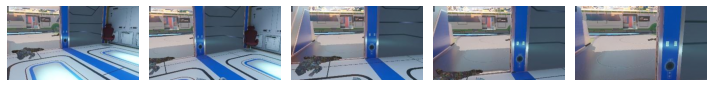

[0 0 1]
label_2


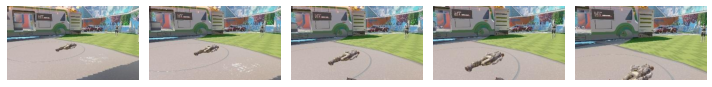

[0 0 1]
label_2


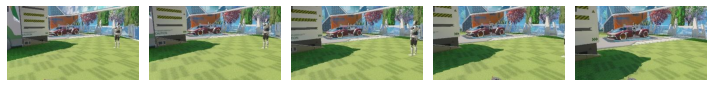

[0 1 0]
label_1


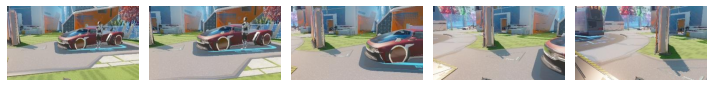

[0 1 0]
label_1


In [28]:
#Cantidad de batches en los que se divide el df
print(train_generator_pov.__len__())

#Comprobamos funcionamiento bach
X_batch, y_batch = train_generator_pov.__getitem__(30)

for i in range(0,batch_size):  # 4 es el maximo de conjunto de imagenes del batch creado
    # Seleccionamos ver la posicion numero 0 del batch creado
    label = comprobar_contenido(X_batch , y_batch,i)
    print(ETIQUETAS[np.argmax(label)])  #Obtener la columna de la etiqueta original


5606


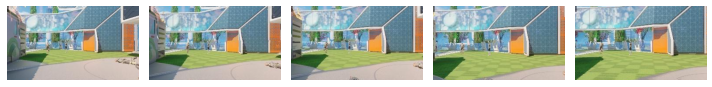

[0 1 0]


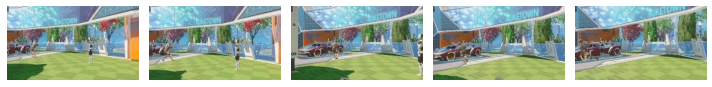

[1 0 0]


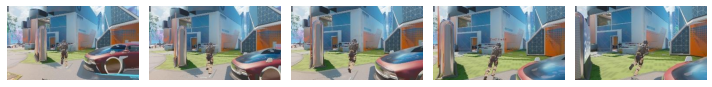

[1 0 0]


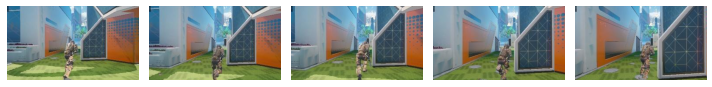

[1 0 0]


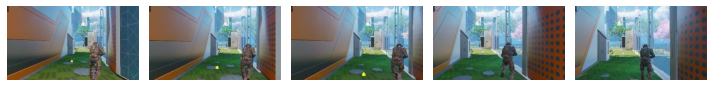

[0 0 1]


In [29]:
#Cantidad de batches en los que se divide el df
print(train_generator_pov.__len__())

#Comprobamos funcionamiento bach
X_batch, y_batch = train_generator_pov.__getitem__(524)

for i in range(0,batch_size):  # 4 es el maximo de conjunto de imagenes del batch creado
    # Seleccionamos ver la posicion numero 0 del batch creado
    comprobar_contenido(X_batch , y_batch,i)

# Modelo - Entreno

In [30]:
from tensorflow.keras.models import Model 
#from keras.layers import Input, ConvLSTM2D, TimeDistributed, BatchNormalization,MaxPooling2D, Dropout, Conv3D, MaxPooling3D, Flatten, Dense
from tensorflow.keras.callbacks import EarlyStopping ,ReduceLROnPlateau,ModelCheckpoint
from tensorflow.keras.regularizers import l2

In [ ]:
from keras.models import Model
from keras.layers import Input, TimeDistributed, Conv2D, LSTM, BatchNormalization, MaxPooling2D, Dropout, UpSampling2D,Flatten,Reshape

def auto_encoder(input_shape_pov):

    input_shape_pov = Input(shape=input_shape_pov)

    # Codificador
    x = TimeDistributed(Conv2D(32, (3, 3), activation='relu', padding='same'))(input_shape_pov)
    x = TimeDistributed(BatchNormalization())(x)
    x = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(x)
    x = TimeDistributed(Dropout(0.2))(x)

    x = TimeDistributed(Conv2D(64, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(BatchNormalization())(x)
    x = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(x)
    x = TimeDistributed(Dropout(0.2))(x)

    x = TimeDistributed(Conv2D(128, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(BatchNormalization())(x)
    x = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(x)
    x = TimeDistributed(Dropout(0.2))(x)

    x = TimeDistributed(Conv2D(245, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(BatchNormalization())(x)
    x = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(x)
    x = TimeDistributed(Dropout(0.2))(x)


    x = TimeDistributed(Flatten())(x)
    x = LSTM(128, return_sequences=True)(x)

    # Restaurar la forma para poder aplicar UpSampling en el decodificador
    x = TimeDistributed(Reshape((21, 37, 256)))(x)

    # Decodificador
    x = TimeDistributed(Conv2D(245, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(UpSampling2D((2, 2)))(x)

    x = TimeDistributed(Conv2D(128, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(UpSampling2D((2, 2)))(x)

    x = TimeDistributed(Conv2D(64, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(UpSampling2D((2, 2)))(x)

    x = TimeDistributed(Conv2D(32, (3, 3), activation='relu', padding='same'))(x)
    x = TimeDistributed(UpSampling2D((2, 2)))(x)

    # Capa de salida ajustada (para que coincida con los 3 canales RGB de la imagen de entrada)
    decoder = TimeDistributed(Conv2D(3, (3, 3), activation='sigmoid', padding='same'))(x)

    # Crear el modelo final
    model = Model(inputs=input_shape_pov, outputs=decoder)
    return model

In [ ]:
from keras.layers import Dense ,Dropout

def auto_encoder_acciones(espacio_latenten):

    # Capas Densa (puedes ajustar el número de unidades y dropout)
    dense_out_02 = Dense(400, activation='relu')(espacio_latenten)
    drop_dense_02 = Dropout((0.5))(dense_out_02)

    # Capas Densa (puedes ajustar el número de unidades y dropout)
    dense_out_03 = Dense(200, activation='relu')(drop_dense_02)
    drop_dense_03 = Dropout((0.5))(dense_out_03)

    # Capa Salida
    output = Dense(len(ETIQUETAS), activation='softmax')(drop_dense_03)

In [31]:
from keras.layers import Input, TimeDistributed ,Conv2D, LSTM, BatchNormalization,MaxPooling2D, Dropout, Flatten, Dense ,Concatenate

def generator(input_shape_pov):

    input_shape_pov = Input(shape=input_shape_pov)

    # Capas Conv2D
    conv2d = TimeDistributed(Conv2D(32, (3, 3), activation='relu', padding='same'))(input_shape_pov)
    batchnorm_layer = TimeDistributed(BatchNormalization())(conv2d)
    maxpool_layer = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(batchnorm_layer)
    dropout_mapa_01 = TimeDistributed(Dropout(0.2))(maxpool_layer)

    conv2d02 = TimeDistributed(Conv2D(64, (3, 3), activation='relu', padding='same'))(dropout_mapa_01)
    batchnorm_layer_02 = TimeDistributed(BatchNormalization())(conv2d02)
    maxpool_layer_02 = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(batchnorm_layer_02)
    dropout_mapa_02 = TimeDistributed(Dropout(0.2))(maxpool_layer_02)

    conv2d03 = TimeDistributed(Conv2D(128, (3, 3), activation='relu', padding='same'))(dropout_mapa_02)
    batchnorm_layer_03 = TimeDistributed(BatchNormalization())(conv2d03)
    maxpool_layer_03 = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(batchnorm_layer_03)
    dropout_mapa_03 = TimeDistributed(Dropout(0.2))(maxpool_layer_03)

    conv2d04 = TimeDistributed(Conv2D(245, (3, 3), activation='relu', padding='same'))(dropout_mapa_03)
    batchnorm_layer_04 = TimeDistributed(BatchNormalization())(conv2d04)
    maxpool_layer_04 = TimeDistributed(MaxPooling2D(pool_size=(2, 2)))(batchnorm_layer_04)
    dropout_mapa_04 = TimeDistributed(Dropout(0.2))(maxpool_layer_04)

    flat1 = TimeDistributed(Flatten())(dropout_mapa_04)

    # Capa LSTM
    lstm01 = LSTM(128 , return_sequences=True)(flat1)
    lstm02 = LSTM(84)(lstm01)

    # Capas Densa (puedes ajustar el número de unidades y dropout)
    dense_out_02 = Dense(400, activation='relu')(lstm02)
    drop_dense_02 = Dropout((0.5))(dense_out_02)

    # Capas Densa (puedes ajustar el número de unidades y dropout)
    dense_out_03 = Dense(200, activation='relu')(drop_dense_02)
    drop_dense_03 = Dropout((0.5))(dense_out_03)

    # Capa Salida
    output = Dense(len(ETIQUETAS), activation='softmax')(drop_dense_03)

    model = Model(inputs=input_shape_pov, outputs=output)
    return model

In [24]:
from tensorflow.keras.optimizers import Adam

def discriminator(input_dim):
    # Entrada del discriminador: recibe un vector de probabilidades o un vector one-hot
    discriminator_input = Input(shape=(input_dim,))
    
    # Capa oculta
    dense_01 = Dense(128, activation='relu')(discriminator_input)
    #dense_02 = Dense(64, activation='relu')(dense_01)
    
    # Salida binaria: 1 para acción real, 0 para acción generada
    output = Dense(1, activation='sigmoid')(dense_01)
    
    # Definición del modelo
    discriminator = Model(discriminator_input, output)
    return discriminator

In [32]:
timesteps = 5
height = 168
width = 300
channels = 3

input_shape_pov = (timesteps, height, width, channels) # Modelo Pov

model_generator = generator(input_shape_pov)
#model_discriminator = discriminator(len(ETIQUETAS))

I0000 00:00:1729245097.497789   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1729245097.498004   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1729245097.498269   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1729245097.498597   38743 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

### GANs

In [26]:
import tensorflow as tf

class GAIL:
    def __init__(self, generator, discriminator, generator_optimizer, discriminator_optimizer , class_weight):
        self.generator = generator
        self.discriminator = discriminator
        self.generator_optimizer = generator_optimizer
        self.discriminator_optimizer = discriminator_optimizer
        self.class_weight = class_weight

    @tf.function
    def train_step(self, images, actions):

        # Las acciones en float32
        actions = tf.cast(actions, tf.float32)

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:  
            # Obtener las probabilidades de acciones generadas
            generated_actions_probs = self.generator(images, training=True)

            # Discriminador: calcular las probabilidades de que las acciones sean reales
            real_logits = self.discriminator(actions, training=True)
            generated_logits = self.discriminator(generated_actions_probs, training=True)

            # Añadir ruido a las etiquetas
            noise_real = 0.1 * tf.random.uniform(shape=tf.shape(real_logits))
            noise_generated = 0.1 * tf.random.uniform(shape=tf.shape(generated_logits))
            
            real_labels = tf.ones_like(real_logits) - noise_real
            generated_labels = tf.zeros_like(generated_logits) + noise_generated

            # Pérdida del discriminador: se puede usar binary crossentropy
            #disc_loss_real = tf.keras.losses.binary_crossentropy(tf.ones_like(real_logits), real_logits)
            disc_loss_real = tf.keras.losses.binary_crossentropy(real_labels, real_logits)
            #disc_loss_generated = tf.keras.losses.binary_crossentropy(tf.zeros_like(generated_logits), generated_logits)
            disc_loss_generated = tf.keras.losses.binary_crossentropy(generated_labels, generated_logits)
            discriminator_loss = disc_loss_real + disc_loss_generated


            # Pérdida del generador, ajustada con class_weight
            generator_loss_unweighted = tf.keras.losses.categorical_crossentropy(actions, generated_actions_probs)

            # Aplicar los pesos de clase
            class_weights_tensor = tf.constant([self.class_weight[i] for i in range(len(self.class_weight))], dtype=tf.float32)
            weights_per_action = tf.reduce_sum(class_weights_tensor * actions, axis=-1)
            weighted_generator_loss = generator_loss_unweighted * weights_per_action
            generator_loss = tf.reduce_mean(weighted_generator_loss)

        # Calcular gradientes y actualizar los pesos del discriminador
        grads_disc = disc_tape.gradient(discriminator_loss, self.discriminator.trainable_variables)
        self.discriminator_optimizer.apply_gradients(zip(grads_disc, self.discriminator.trainable_variables))

        # Calcular gradientes y actualizar los pesos del generador
        grads_gen = gen_tape.gradient(generator_loss, self.generator.trainable_variables)
        self.generator_optimizer.apply_gradients(zip(grads_gen, self.generator.trainable_variables))

        return generator_loss, discriminator_loss

In [27]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam

# Compilación del generador
generator_optimizer = Adam(learning_rate=0.0003, beta_1=0.5)
model_generator.compile(optimizer=generator_optimizer, loss='categorical_crossentropy', metrics=['categorical_accuracy'])

# Compilación del discriminador
discriminator_optimizer = Adam(learning_rate=0.0001, beta_1=0.5)
model_discriminator.compile(optimizer=discriminator_optimizer, loss='binary_crossentropy', metrics=['accuracy'])

In [28]:
import numpy as np
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# Ejemplo de uso:
gail = GAIL(model_generator, model_discriminator, generator_optimizer, discriminator_optimizer,pesos_train)

# Callbacks
early_stopping = EarlyStopping(monitor='val_categorical_accuracy', patience=40, verbose=1, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('modelo_merge_checkpoint.keras', monitor='val_categorical_accuracy', save_best_only=True, verbose=1)


# Asegura que el callback conoce el modelo sobre el cual actuar
model_checkpoint.set_model(model_generator)
early_stopping.set_model(model_generator)

# Asumiendo que tienes un bucle de entrenamiento
for epoch in range(1000):
    for batch_index in range(train_generator_Mapa.__len__()):
        X_batch, y_batch = train_generator_Mapa.__getitem__(batch_index)

        # Verificar que el lote no esté vacío
        if X_batch.shape[0] == 0 or y_batch.shape[0] == 0:
            print(f"Lote vacío en el índice de training: {batch_index}, saltando este batch.")
            continue

        generator_loss, discriminator_loss = gail.train_step(X_batch, y_batch)
        print(f"Epoch: {epoch}, Batch: {batch_index}, Generator Loss: {generator_loss.numpy()}, Discriminator Loss: {discriminator_loss.numpy()}")

    val_losses = []
    val_accuracies = []
    
    for batch_index_02 in range(valid_generator_Mapa.__len__()):
        X_batch_val, y_batch_val = valid_generator_Mapa.__getitem__(batch_index_02)
        
        # Verificar que el lote de validación no esté vacío
        if X_batch_val.shape[0] == 0 or y_batch_val.shape[0] == 0:
            print(f"Lote vacío en el índice de validación: {batch_index_02}, saltando este batch.")
            continue
        val_loss, val_accuracy = model_generator.evaluate(X_batch_val, y_batch_val, verbose=0)
        #print(f"Epoch: {epoch}, Validation Loss: {val_loss}, Validation Accuracy: {val_accuracy}")
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)
    
    avg_val_loss = np.mean(val_losses)
    avg_val_accuracy = np.mean(val_accuracies)
    
    model_checkpoint.on_epoch_end(epoch, {'val_categorical_accuracy': avg_val_accuracy})
    early_stopping.on_epoch_end(epoch, {'val_categorical_accuracy': avg_val_accuracy})
    if early_stopping.model.stop_training:
        print("Early stopping triggered. Training stopped.")
        break

    print(f"Epoch {epoch} - Avg Validation Loss: {avg_val_loss}, Avg Validation Accuracy: {avg_val_accuracy}")

2024-10-16 21:09:45.582710: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:966] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape infunctional_1/time_distributed_3_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2024-10-16 21:09:46.611054: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
W0000 00:00:1729105788.693687    5164 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729105788.795944    5164 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729105788.796949    5164 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729105788.888774    5164 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729105788.890099    5164 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be 

Epoch: 0, Batch: 0, Generator Loss: 15.946983337402344, Discriminator Loss: [1.43801   1.4077147 1.4116111 1.410665  1.4127431]
Epoch: 0, Batch: 1, Generator Loss: 1.2587547302246094, Discriminator Loss: [1.4965165 1.4121872 1.403862  1.4124122 1.4165663]
Epoch: 0, Batch: 2, Generator Loss: 1.1829866170883179, Discriminator Loss: [1.3697813 1.4103351 1.4060645 1.4098046 1.4068682]
Epoch: 0, Batch: 3, Generator Loss: 2.056333541870117, Discriminator Loss: [1.365092  1.401091  1.4410677 1.4033885 1.4040096]
Epoch: 0, Batch: 4, Generator Loss: 1.5588610172271729, Discriminator Loss: [1.4088492 1.3599684 1.3568134 1.3664837 1.3599921]
Epoch: 0, Batch: 5, Generator Loss: 1.1309221982955933, Discriminator Loss: [1.4984002 1.411092  1.4030479 1.4044664 1.409882 ]
Epoch: 0, Batch: 6, Generator Loss: 1.834959626197815, Discriminator Loss: [1.5013876 1.4088843 1.4083252 1.4864275 1.407552 ]
Epoch: 0, Batch: 7, Generator Loss: 1.6087141036987305, Discriminator Loss: [1.4910945 1.3608745 1.3888321

2024-10-16 21:27:26.030404: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:966] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape infunctional_1/time_distributed_3_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
W0000 00:00:1729106846.440662    5159 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729106846.441502    5159 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729106846.442249    5159 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729106846.443022    5159 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729106846.443817    5159 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729106846.444655    5159 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will 

Epoch: 0, Batch: 4274, Generator Loss: 1.2139804363250732, Discriminator Loss: [0.24690662 0.34813914]

Epoch 1: val_categorical_accuracy improved from -inf to 0.07391, saving model to modelo_merge_checkpoint.keras


W0000 00:00:1729107062.243543    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.244288    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.244996    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.245710    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.246431    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.247186    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.247926    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.248654    5150 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729107062.249434    5150 gp

Epoch 0 - Avg Validation Loss: 2.088486804744206, Avg Validation Accuracy: 0.07391304465440604
Epoch: 1, Batch: 0, Generator Loss: 20.11895179748535, Discriminator Loss: [2.0953314  0.47730803 0.4027719  0.35493258 0.41068187]
Epoch: 1, Batch: 1, Generator Loss: 1.3098827600479126, Discriminator Loss: [0.52490956 0.35108534 0.3410802  0.23825158 0.3585341 ]
Epoch: 1, Batch: 2, Generator Loss: 1.0639187097549438, Discriminator Loss: [0.2564766  0.45551795 0.5986545  0.4533572  0.52017695]
Epoch: 1, Batch: 3, Generator Loss: 2.0925307273864746, Discriminator Loss: [0.41075045 0.21804701 0.5075279  0.580062   0.4498046 ]
Epoch: 1, Batch: 4, Generator Loss: 1.4504834413528442, Discriminator Loss: [0.24585111 0.4507526  0.27431485 0.38396493 0.391878  ]
Epoch: 1, Batch: 5, Generator Loss: 1.322788119316101, Discriminator Loss: [0.51261306 0.30740315 0.34568393 0.5374835  0.36669558]
Epoch: 1, Batch: 6, Generator Loss: 1.6990684270858765, Discriminator Loss: [0.5302792  0.6187624  0.35513642

KeyboardInterrupt: 

## Callbacks

In [33]:
# Compilar el modelo
model_generator.compile(optimizer='adam', loss='categorical_crossentropy',metrics=['categorical_accuracy'])

#Callbacks
early_stopping = EarlyStopping(monitor= 'val_categorical_accuracy', patience=20, verbose=1, restore_best_weights=True)
model_checkpoint = ModelCheckpoint('modelo_merge_checkpoint.keras',monitor='val_categorical_accuracy',save_best_only=True,verbose=1)
'''
reduce_lr = ReduceLROnPlateau(  monitor='val_categorical_accuracy',
                                factor=0.2,
                                patience=5,
                                min_lr=0.00001,
                                verbose=1)
'''

"\nreduce_lr = ReduceLROnPlateau(  monitor='val_categorical_accuracy',\n                                factor=0.2,\n                                patience=5,\n                                min_lr=0.00001,\n                                verbose=1)\n"

In [34]:
model_generator.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 5, 168, 300, 3) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed                │ (None, 5, 168, 300,    │           896 │
│ (TimeDistributed)               │ 32)                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_1              │ (None, 5, 168, 300,    │           128 │
│ (TimeDistributed)               │ 32)                    │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_2              │ (None, 5, 84, 150, 32) │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_3              │ (None, 5, 84, 150, 32) │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_4              │ (None, 5, 84, 150, 64) │        18,496 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_5              │ (None, 5, 84, 150, 64) │           256 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_6              │ (None, 5, 42, 75, 64)  │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_7              │ (None, 5, 42, 75, 64)  │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_8              │ (None, 5, 42, 75, 128) │        73,856 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_9              │ (None, 5, 42, 75, 128) │           512 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_10             │ (None, 5, 21, 37, 128) │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_11             │ (None, 5, 21, 37, 128) │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_12             │ (None, 5, 21, 37, 245) │       282,485 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_13             │ (None, 5, 21, 37, 245) │           980 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_14             │ (None, 5, 10, 18, 245) │             0 │
│ (TimeDistributed)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ time_distributed_15             │ (None, 5, 10, 18, 245) │             0 │
│ (TimeDistributed)               │                        │             

 Total params: 23,209,228 (88.54 MB)

 Trainable params: 23,208,290 (88.53 MB)

 Non-trainable params: 938 (3.66 KB)

In [ ]:
import time

# Registro del tiempo de inicio
start_time = time.time()

# Entrenamiento Mini-Mapa
history = model_generator.fit(train_generator_pov,
                    epochs=1000,
                    validation_data=valid_generator_pov,
                    callbacks=[early_stopping,model_checkpoint],
                    class_weight=pesos_train
                    )

model_generator.save('prueba_pov01_.h5')

# Registro del tiempo de finalización
end_time = time.time()

Epoch 1/1000


2024-10-18 11:52:39.770020: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
W0000 00:00:1729245160.250109   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.317236   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.318359   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.380265   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.381433   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.437753   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.438942   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245160.453393   48694 gpu_t

   1/5606 ━━━━━━━━━━━━━━━━━━━━ 11:14:22 7s/step - categorical_accuracy: 0.2000 - loss: 1.1295

W0000 00:00:1729245162.665157   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.727760   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.729080   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.731793   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.733601   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.736077   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.737976   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.739502   48694 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1729245162.741968   48694 gp

5606/5606 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step - categorical_accuracy: 0.3415 - loss: 1.1080
Epoch 1: val_categorical_accuracy improved from -inf to 0.27698, saving model to modelo_merge_checkpoint.keras
5606/5606 ━━━━━━━━━━━━━━━━━━━━ 1735s 308ms/step - categorical_accuracy: 0.3415 - loss: 1.1080 - val_categorical_accuracy: 0.2770 - val_loss: 1.1039
Epoch 2/1000
5606/5606 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step - categorical_accuracy: 0.3457 - loss: 1.0974
Epoch 2: val_categorical_accuracy improved from 0.27698 to 0.33424, saving model to modelo_merge_checkpoint.keras
5606/5606 ━━━━━━━━━━━━━━━━━━━━ 1743s 311ms/step - categorical_accuracy: 0.3456 - loss: 1.0974 - val_categorical_accuracy: 0.3342 - val_loss: 1.0946
Epoch 3/1000
5606/5606 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step - categorical_accuracy: 0.3128 - loss: 1.1008
Epoch 3: val_categorical_accuracy did not improve from 0.33424
5606/5606 ━━━━━━━━━━━━━━━━━━━━ 1642s 293ms/step - categorical_accuracy: 0.3128 - loss: 1.1008 - val_categorical_accur

In [57]:
model_generator.save('modelo_afable.keras')

In [26]:
import time

# Registro del tiempo de inicio
start_time = time.time()

# Entrenamiento Mini-Mapa
history = model.fit(combined_generator, epochs=1000, validation_data=valid_combine_generator, callbacks=[early_stopping,model_checkpoint])

model.save('modelo_merge.h5')

# Registro del tiempo de finalización
end_time = time.time()

Epoch 1/1000


2024-07-13 07:49:15.353959: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8907
2024-07-13 07:49:17.996955: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x73aa989c37d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-07-13 07:49:17.996974: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce GTX 1070, Compute Capability 6.1
2024-07-13 07:49:18.465883: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-07-13 07:49:20.488628: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


504/504 [==============================] - ETA: 0s - loss: 1.0620 - categorical_accuracy: 0.3941
Epoch 1: val_categorical_accuracy improved from -inf to 0.42760, saving model to modelo_merge_checkpoint.h5


/usr/lib/python3/dist-packages/keras/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


504/504 [==============================] - 137s 253ms/step - loss: 1.0620 - categorical_accuracy: 0.3941 - val_loss: 1.0238 - val_categorical_accuracy: 0.4276
Epoch 2/1000
504/504 [==============================] - ETA: 0s - loss: 1.0452 - categorical_accuracy: 0.4248
Epoch 2: val_categorical_accuracy did not improve from 0.42760
504/504 [==============================] - 120s 238ms/step - loss: 1.0452 - categorical_accuracy: 0.4248 - val_loss: 1.0195 - val_categorical_accuracy: 0.4191
Epoch 3/1000
504/504 [==============================] - ETA: 0s - loss: 1.0232 - categorical_accuracy: 0.4364
Epoch 3: val_categorical_accuracy improved from 0.42760 to 0.44378, saving model to modelo_merge_checkpoint.h5
504/504 [==============================] - 126s 249ms/step - loss: 1.0232 - categorical_accuracy: 0.4364 - val_loss: 1.0064 - val_categorical_accuracy: 0.4438
Epoch 4/1000
504/504 [==============================] - ETA: 0s - loss: 1.0054 - categorical_accuracy: 0.4673
Epoch 4: val_catego

In [43]:
# Calcula la diferencia de tiempo en segundos
training_time_seconds = end_time - start_time

# Convierte el tiempo de entrenamiento a horas
training_time_hours = training_time_seconds / 3600  # 3600 segundos en una hora

# Imprime el tiempo de entrenamiento en horas
print(f"El entrenamiento duró aproximadamente {training_time_hours:.2f} horas.")

El entrenamiento duró aproximadamente 15.72 horas.


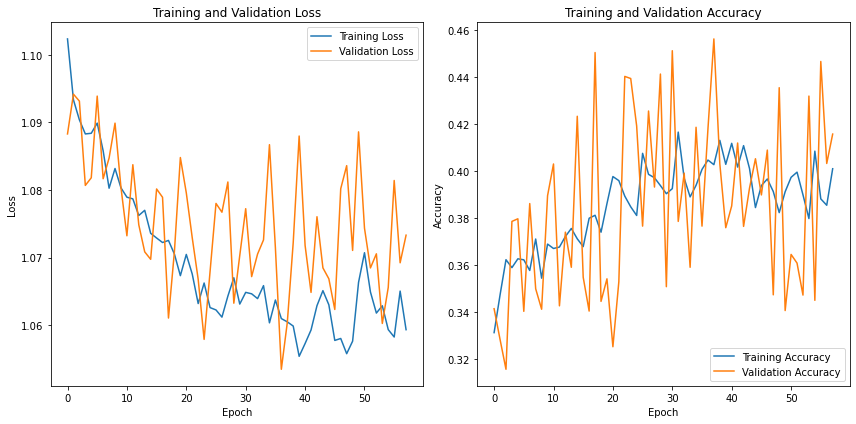

In [44]:
# Extrae la información de la historia
train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_accuracy = history.history['categorical_accuracy']
val_accuracy = history.history['val_categorical_accuracy']

# Crea subgráficos para la pérdida y la precisión
plt.figure(figsize=(12, 6))

# Gráfico de pérdida
plt.subplot(1, 2, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Gráfico de precisión
plt.subplot(1, 2, 2)
plt.plot(train_accuracy, label='Training Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Ajusta el diseño de los subgráficos
plt.tight_layout()

# Muestra los gráficos
plt.show()

In [29]:
# Crear una instancia del generador combinado
test_generator = CombinedDataGenerator(test_generator_Mapa, test_generator_Pov)

656


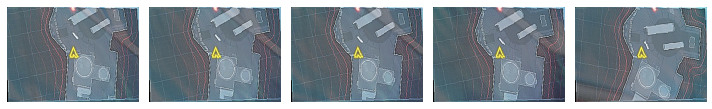

[1 0 0 0 0 0 0 0 0 0]


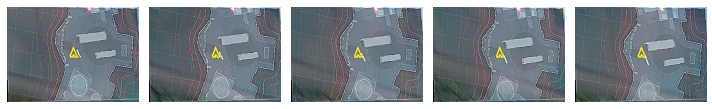

[0 0 1 0 0 0 0 0 0 0]


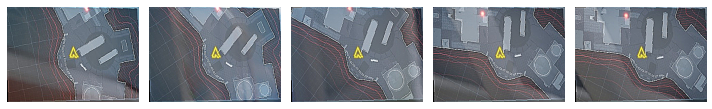

[1 0 0 0 0 0 0 0 0 0]


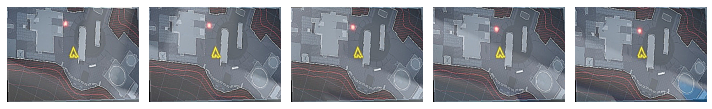

[0 0 0 1 0 0 0 0 0 0]


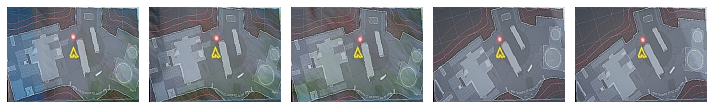

[0 0 1 0 0 0 0 0 0 0]


In [41]:
#Cantidad de batches en los que se divide el df
print(test_generator_Mapa.__len__())

#Comprobamos funcionamiento bach
X_batch, y_batch = test_generator_Mapa.__getitem__(2)

for i in range(0,batch_size):  # 4 es el maximo de conjunto de imagenes del batch creado
    # Seleccionamos ver la posicion numero 0 del batch creado
    comprobar_contenido(X_batch , y_batch,i)

In [45]:
resultado = model_generator.evaluate(test_generator_Mapa)

656/656 ━━━━━━━━━━━━━━━━━━━━ 41s 63ms/step - categorical_accuracy: 0.4619 - loss: 1.0601


In [46]:
resultado

[1.0655126571655273, 0.4559047818183899]

## Ver como se comporta el modelo

In [47]:
from sklearn.metrics import f1_score,confusion_matrix

valores_originales = df_test_mapa[ETIQUETAS].copy()
valores_originales.reset_index(drop=True, inplace=True)

In [48]:
valores_originales

,label_0,label_1,label_2
0,0,1,0
1,0,1,0
2,0,0,1
3,0,1,0
4,0,0,1
...,...,...,...
3272,0,1,0
3273,0,0,1
3274,0,1,0
3275,1,0,0


In [49]:
valores_originales

,label_0,label_1,label_2
0,0,1,0
1,0,1,0
2,0,0,1
3,0,1,0
4,0,0,1
...,...,...,...
3272,0,1,0
3273,0,0,1
3274,0,1,0
3275,1,0,0


In [50]:
# Generar predicciones en el conjunto de prueba
predictions = model_generator.predict(test_generator_Mapa)

656/656 ━━━━━━━━━━━━━━━━━━━━ 28s 41ms/step


In [51]:
predictions

array([[0.3379498 , 0.31652883, 0.34552133],
       [0.33667666, 0.31929696, 0.34402636],
       [0.34222287, 0.30275306, 0.355024  ],
       ...,
       [0.33756557, 0.33790222, 0.3245322 ],
       [0.33547878, 0.31015697, 0.35436425],
       [0.32516077, 0.3160132 , 0.35882604]], dtype=float32)

In [52]:
# Convertir las probabilidades a etiquetas de clase
predicted_classes = np.argmax(predictions, axis=1)

#Convertimos las etiquetas one  hot a numeros
true_classes = np.argmax(valores_originales.values, axis=1)

In [53]:
predicted_classes[:20]

array([2, 2, 2, 2, 0, 2, 1, 1, 2, 2, 0, 1, 1, 2, 1, 1, 1, 0, 0, 1])

In [54]:
true_classes[:20]

array([1, 1, 2, 1, 2, 1, 2, 1, 2, 0, 2, 1, 2, 2, 1, 1, 2, 1, 2, 2])

In [55]:
# Calcular el F1 Score
f1 = f1_score(true_classes, predicted_classes, average='weighted')
print('F1 Score:', f1)

F1 Score: 0.408965898105383


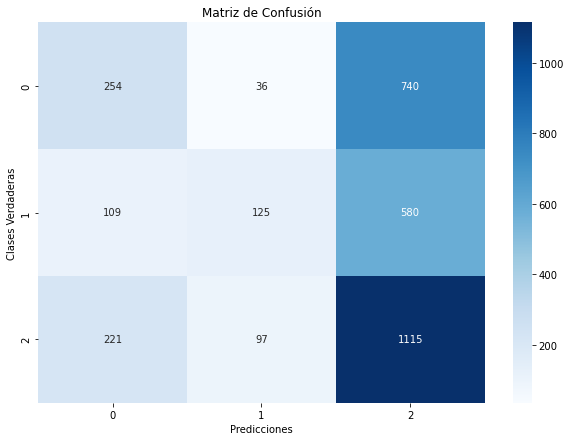

In [56]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Calcular la matriz de confusión
cm = confusion_matrix(true_classes, predicted_classes)

# Crear un gráfico de la matriz de confusión
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')

# Añadir etiquetas y título
plt.xlabel('Predicciones')
plt.ylabel('Clases Verdaderas')
plt.title('Matriz de Confusión')

# Mostrar el gráfico
plt.show()

## Resultatado Entrenamientos

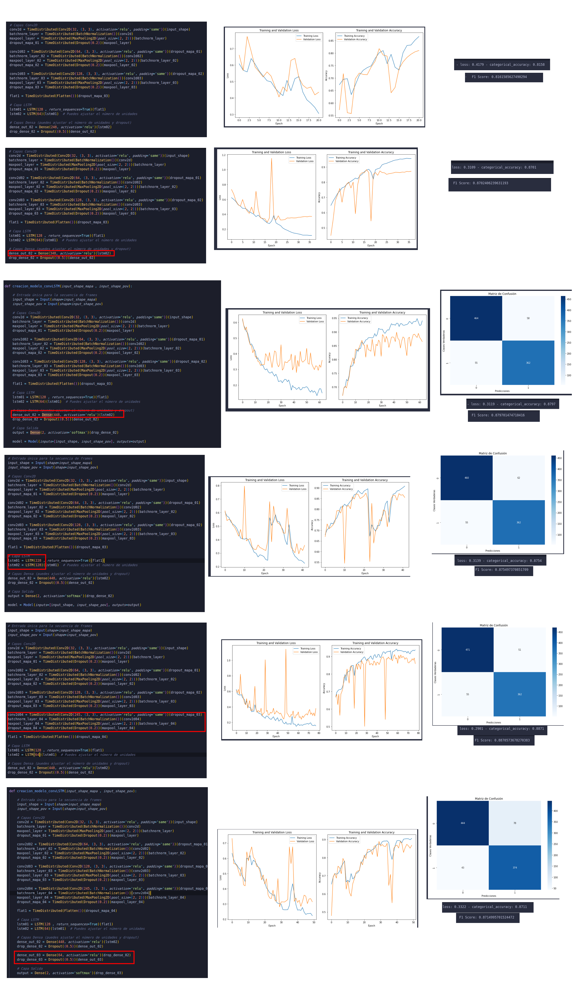